# Import thư viện

In [2]:
import os
from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import scipy.io
from scipy.signal import butter, lfilter
import mne
import pandas as pd
import numpy as np
import antropy as ant
import seaborn as sns
sns.set(font_scale=1.2)

from sklearn.ensemble import RandomForestClassifier as rf
from sklearn.linear_model import LogisticRegression as lr
from sklearn.neighbors import KNeighborsClassifier as KNN
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score

In [3]:
SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          
plt.rc('axes', titlesize=SMALL_SIZE)     
plt.rc('axes', labelsize=MEDIUM_SIZE)    
plt.rc('xtick', labelsize=SMALL_SIZE)    
plt.rc('ytick', labelsize=SMALL_SIZE)    
plt.rc('legend', fontsize=SMALL_SIZE)    
plt.rc('figure', titlesize=BIGGER_SIZE)  

In [14]:
# GSN-HydroCel-128: layout chuẩn cho việc đặt 128 điện cực lên đầu người
montage = mne.channels.make_standard_montage('GSN-HydroCel-128')
# fig = montage.plot(kind='3d',scale_factor = 20)

In [15]:
def file_importer(path,type =1): # hàm đọc dữ liệu của file.raw
  if type == 1:
    df = mne.io.read_raw_egi(path,verbose=True)
    df.drop_channels('E129') #kênh 0 (bỏ đi)
  else:
    ch_names = ['E'+str(i+1) for i in range(128)]
    sampling_freq = 250
    mat = scipy.io.loadmat(path)
    key = list(mat.keys())
    data = key[3]
    a_mat = mat[data]
    info = mne.create_info(ch_names= ch_names,
                       ch_types='eeg', verbose=None,
                       sfreq=sampling_freq)
    df = mne.io.RawArray(a_mat[:-1,:], info)
  df.set_montage(montage)
  df.plot_psd()
  return df  

Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010002erp 20150416 1131.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


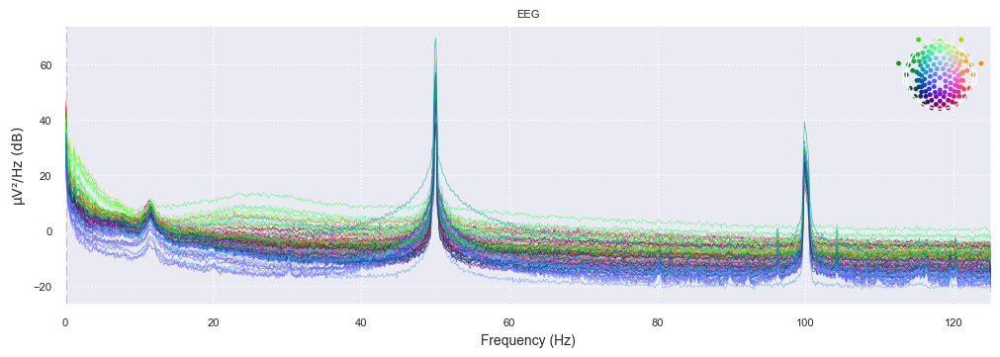

In [16]:
# đọc thử dữ liệu dạng signal của từng sóng đầu vào
path = 'C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_ERP_Lanzhou_2015/EEG_128channels_ERP_lanzhou_2015/02010002erp 20150416 1131.raw'
raw_erp = file_importer(path)

# 16 channels

In [7]:
# lấy theo chuẩn 16 cực ở trung tâm các vùng

Electrode_map = {'C3':'E36','C4':'E104','F3':'E24','F4':'E124','F7':'E33','F8':'E122',
                 'FP1':'E22','FP2':'E9','O1':'E70','O2':'E83','P3':'E52','P4':'E92',
                 'T3-T7':'E45','T4-T8':'E108','T5-P7':'E58','T6-P8':'E96'}

# Electrode_understanding = {'Left-Central':'E36','Right-Central':'E104','Front-Left':'E24','Front-Right':'E124',
#                            'Front-Far left':'E33','Front-Far Right':'E122',
#                            'Forehead (above left eye)':'E22','Forehead (above Right eye)':'E9',
#                            'Back-left to Center':'E70','Back-Right to Center':'E83','Back-Above E70':'E52',
#                            'Back-Above E83':'E92','Side Left':'E45','Side Right':'E108','Left':'E58','Right':'E96'}

list(Electrode_map.values())

['E36',
 'E104',
 'E24',
 'E124',
 'E33',
 'E122',
 'E22',
 'E9',
 'E70',
 'E83',
 'E52',
 'E92',
 'E45',
 'E108',
 'E58',
 'E96']

# Band Pass filter [0 - 30]Hz

Initial Power distribution
After filtering - Power distribution
Reading 0 ... 197401  =      0.000 ...   789.604 secs...


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.7s


NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


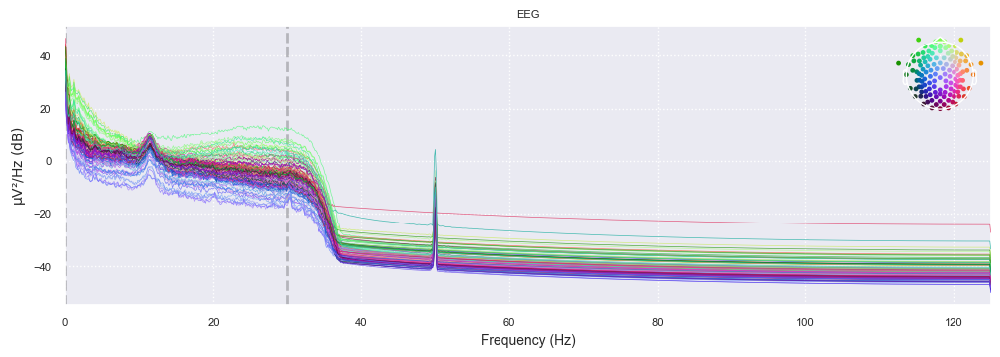

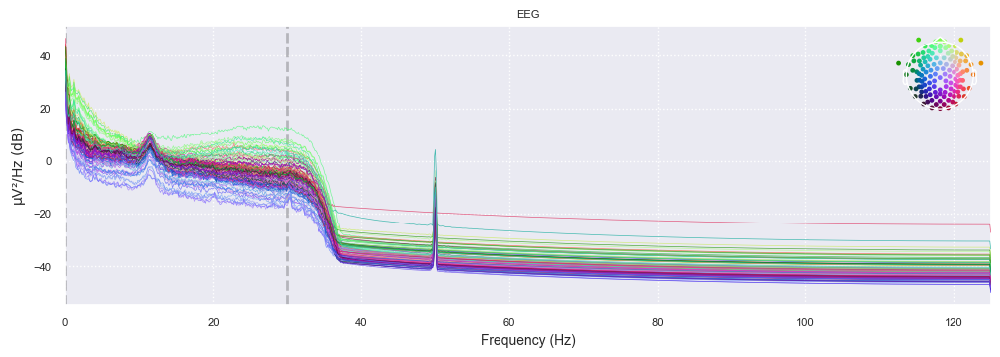

In [17]:
# Sử dụng bộ lọc Hamming để lọc bớt nhiễu trong sóng
# Ta chỉ xét trong khoảng từ 0 - 30Hz vì lấy các sóng basic
sampling_freq = 250 # tần số lấy mẫu theo chuẩn đầu vào của EEG (người ta đo theo như thế)

l_freq = 0
h_freq = 30

def raw_trunc(simulated_raw):
  simulated_raw =simulated_raw.copy().load_data() # tạo 1 bản sao để tránh bị chỉnh sửa ngay trên chính bản gốc
  simulated_raw_truc = simulated_raw.filter(l_freq,h_freq,method = 'fir',fir_window = 'hamming')
  return simulated_raw_truc
print("Initial Power distribution")
print("After filtering - Power distribution")
raw_trunct = raw_trunc(raw_erp)
raw_trunct.plot_psd()

# Tính toán biên độ của từng sóng cơ bản

In [20]:
def butter_bandpass_filter(data):
  
  fs = 256  # Tần số lấy mẫu
  eeg_bands = {'delta':(0,4),
               'Theta': (4, 8),
               'Alpha': (8, 12),
               'Beta': (12, 30),
               'Normal':(0,30)} # 4 sóng cơ bản và 1 sóng tổng

  # FFT để chuyển tín hiệu từ miền thời gian sang tần số
  fft_vals = np.absolute(np.fft.rfft(data))

  fft_freq = np.fft.rfftfreq(len(data), 1.0/fs)

  eeg_band_mean = dict()
  eeg_band_median = dict()
  eeg_band_max = dict()
  eeg_band_min = dict()
  eeg_band_fft = dict()

  for band in eeg_bands:  # với từng sóng cơ bản
    freq_ix = np.where((fft_freq >= eeg_bands[band][0]) & 
                      (fft_freq <= eeg_bands[band][1]))[0] # tần số sóng giới hạn của từng dải sóng cơ bản
    eeg_band_fft[band] = np.mean(fft_vals[freq_ix])# giá trị trung bình biên độ
    eeg_band_median[band] = np.median(fft_vals[freq_ix])# giá trị trung vị biên độ
    eeg_band_mean[band] = np.mean(fft_vals[freq_ix])
    eeg_band_max[band] = np.max(fft_vals[freq_ix])
    eeg_band_min[band] = np.min(fft_vals[freq_ix])

  return eeg_band_mean,eeg_band_median,eeg_band_max,eeg_band_min,eeg_band_fft

# Feature Extraction

In [21]:
def signal_extractor(df,prefix): # trích xuất đặc trưng tuyến tính (biên độ)
  d = df.get_data()  
  ch_names = df.ch_names
  val_dict = dict()
  for i in np.arange(d.shape[0]):
      data = d[i,:]
      eeg_band_mean,eeg_band_median,eeg_band_max,eeg_band_min,eeg_band_fft = butter_bandpass_filter(data)
      # lấy các giá trị đặc trưng biên độ của từng sóng con
      
      # giá trị biên độ của cả đoạn
      mean = eeg_band_mean['Normal']
      max = eeg_band_max['Normal']
      min = eeg_band_min['Normal']
      median = eeg_band_median['Normal']
      
      # lấy giá trị fft của từng sóng đơn, và trung bình trung vị của cả đoạn
      alpha = eeg_band_fft['Alpha']
      beta = eeg_band_fft['Beta']
      delta = eeg_band_fft['delta']
      theta = eeg_band_fft['Theta']
      objects = [alpha, beta, delta, theta, mean, max, min, median]
      val_dict[ch_names[i]] = objects
  result = pd.DataFrame(val_dict).T 

  result.columns = ['alpha_'+prefix,'beta_'+prefix,'delta_'+prefix,'theta_'+prefix,'mean_'+prefix,'max_'+prefix,'min_'+prefix,'median_'+prefix]
  return result

In [22]:
signal_extractor(raw_erp,'1').head()

,alpha_1,beta_1,delta_1,theta_1,mean_1,max_1,min_1,median_1
E1,0.009197,0.004703,0.154718,0.011922,0.026270,126.454099,0.000049,0.005837
E2,0.008355,0.004442,0.521094,0.010765,0.074704,1315.108658,0.000039,0.005473
E3,0.010076,0.006516,0.840316,0.014003,0.119179,2109.456340,0.000040,0.008073
E4,0.010546,0.005984,0.338663,0.014799,0.052131,526.747381,0.000038,0.007736
E5,0.010841,0.005423,0.481406,0.016488,0.071094,884.714861,0.000080,0.007104


In [23]:
# ĐẶC TRƯNG PHI TUYẾN BAO GỒM ENTROY, SVDEN,...
def nli_features(df,prefix):
  ch_names = df.ch_names
  val_dict = dict()
  overall = raw_trunc(df.copy())
  d = overall.get_data()  

  for i in range(d.shape[0]):
    signal = d[i,:]
    svd_entropy = ant.svd_entropy(signal, normalize=True)
    spectral_entropy = ant.spectral_entropy(signal, sf=250, method='welch', normalize=True)
    perm_entropy = ant.perm_entropy(d[i,:], normalize=True)
    
    objects = [svd_entropy,spectral_entropy,perm_entropy]
    val_dict[ch_names[i]] = objects
  result = pd.DataFrame(val_dict).T
  result.columns = ['nl_svden_'+prefix,'nl_spec_en'+prefix,'nl_permen'+prefix]
  return result  

In [24]:
nli_features(raw_erp,'1').head()

Reading 0 ... 197401  =      0.000 ...   789.604 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


,nl_svden_1,nl_spec_en1,nl_permen1
E1,0.021018,0.425123,0.706312
E2,0.003035,0.408795,0.711288
E3,0.002484,0.484828,0.727824
E4,0.007528,0.510873,0.727160
E5,0.003143,0.530171,0.716342


NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


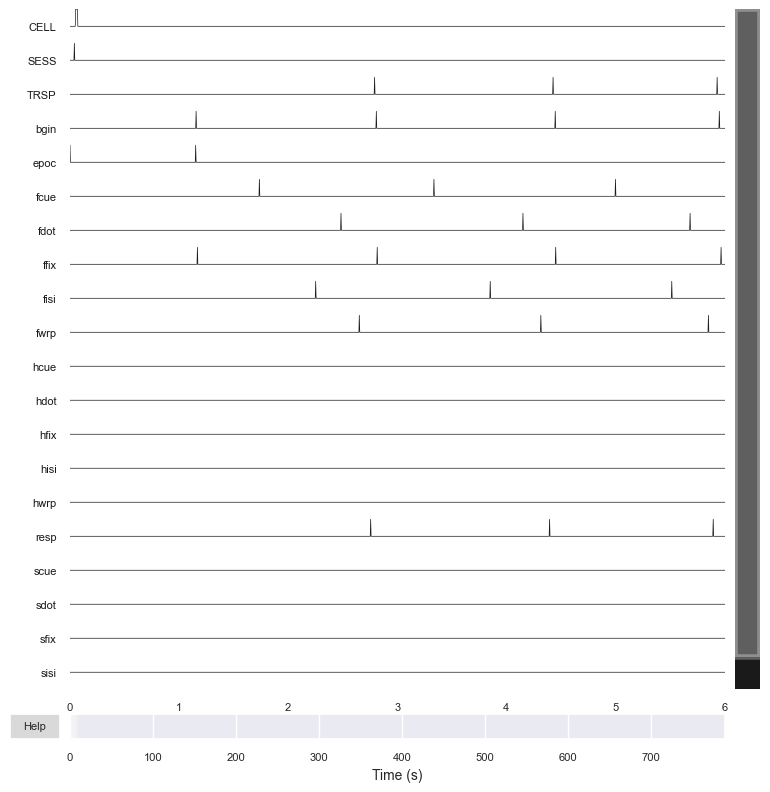

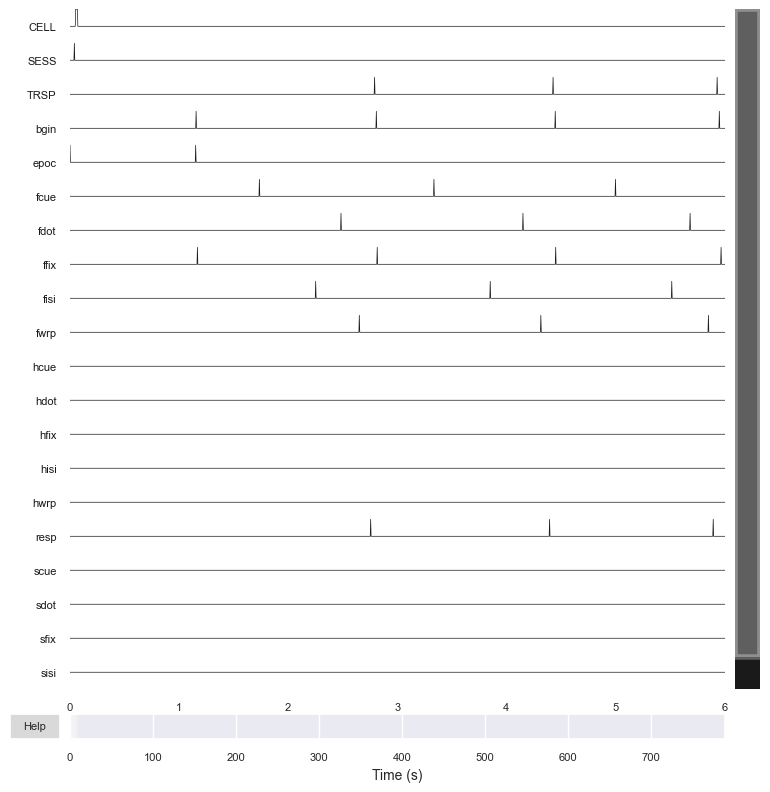

In [26]:
# CÁC KÍCH THÍCH ĐẦU VÀO FEAR, HAPPY, SAD
raw_erp.copy().pick_types(meg=False, stim=True).plot(start=0, duration=6)

### *Mỗi kích thích đầu vào đều có ở một thời gian nhất định (ví dụ 10s đầu cho xem ảnh happy 10s sau cho xem fear...) nên cứ từ đó sẽ trích xuất những cái tác động của nó lên*

In [31]:
def channel_explorer(df):
  # lấy dữ liệu của các kênh kích thích 'stim' = stimulus = kích thích = true
  list_channels = df.copy().pick_types(meg=False, stim=True).ch_names
  
  temp = pd.DataFrame(df.copy().pick_types(meg=False, stim=True).get_data().T)
  
  temp.columns = list_channels
  temp.reset_index(inplace = True)

  df_happy = pd.DataFrame()
  df_sad = pd.DataFrame()
  df_fear = pd.DataFrame()

  for col in temp.columns:
    if col!='index':
      # dựa vào tên cột để phân loại cảm xúc, sau đó xác định thời điểm bắt đầu và kết thúc của cảm xúc
      # fear
      if col in ['fcue', 'fdot','ffix', 'fisi', 'fwrp']:
        te = pd.DataFrame(temp[temp[col]==1].agg({'index':['max','min']}))
        te.columns = [col]
        df_fear = pd.concat([df_fear,te],axis = 1)
      # happy
      if col in ['hcue', 'hdot', 'hfix', 'hisi', 'hwrp']:
        te = pd.DataFrame(temp[temp[col]==1].agg({'index':['max','min']}))
        te.columns = [col]
        df_happy = pd.concat([df_happy,te],axis = 1)
      # sad
      if col in ['scue', 'sdot', 'sfix', 'sisi', 'swrp']:
        te = pd.DataFrame(temp[temp[col]==1].agg({'index':['max','min']}))
        te.columns = [col]
        df_sad = pd.concat([df_sad,te],axis = 1)
  event_dict = {'fear':(np.min(df_fear,axis = 1)[1],np.max(df_fear,axis = 1)[0]),
                'sad':(np.min(df_sad,axis = 1)[1],np.max(df_sad,axis = 1)[0]),
                'happy':(np.min(df_happy,axis = 1)[1],np.max(df_happy,axis = 1)[0])}
  print(event_dict)
  #Check for sequence
  sequence_order = np.argsort([i[0] for i in list(event_dict.values())])
  vals = list(event_dict.keys())
  sequence = [vals[i] for i in sequence_order]
  print("sequence: ")
  print(sequence)# thứ tự xuất hiện cảm xúc
  # thười điểm bắt đầu và kết thúc
  print("thời điểm xuất hiện của từng cảm xúc")
  print(event_dict[sequence[0]][1])
  print(event_dict[sequence[1]][0])
  print(event_dict[sequence[1]][1])
  print(event_dict[sequence[2]][0])

  val = 0
  if (event_dict[sequence[0]][1]>event_dict[sequence[1]][0]) or (event_dict[sequence[1]][1]>event_dict[sequence[2]][0]):
    val = 1
    print("Problem with event spacings - Kindly check")
  fear_raw = df.copy().crop(tmin=event_dict['fear'][0]/250,tmax=event_dict['fear'][1]/250)
  happy_raw = df.copy().crop(tmin=event_dict['happy'][0]/250,tmax=event_dict['happy'][1]/250)
  sad_raw = df.copy().crop(tmin=event_dict['sad'][0]/250,tmax=event_dict['sad'][1]/250)
  return fear_raw,happy_raw,sad_raw      

Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010002erp 20150416 1131.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (292, 65215), 'sad': (131520, 197206), 'happy': (65414, 130892)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
65215
65414
130892
131520


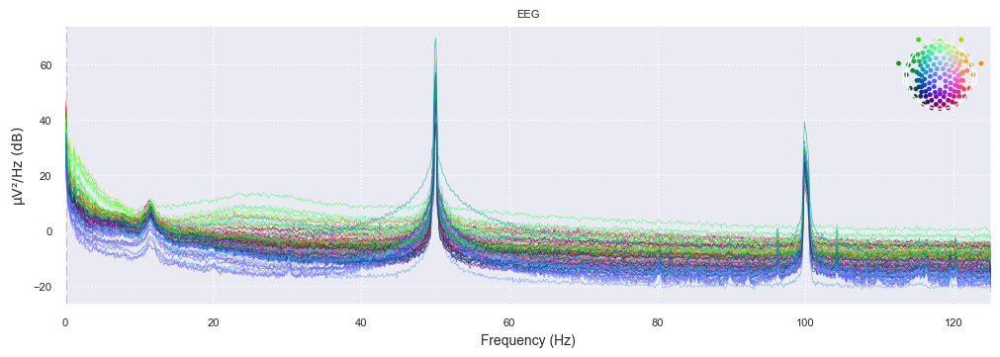

In [32]:
df_1 = file_importer(path = 'C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_ERP_Lanzhou_2015/EEG_128channels_ERP_lanzhou_2015/02010002erp 20150416 1131.raw') #lấy sóng đầu vào dạng wave form
fear,happy,sad = channel_explorer(df_1) 
# cảm xúc sẽ từ fear [292, 65215]; happy [65414, 130892]; sad [131520, 197206]

# Trích xuất --> bỏ vào file

Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010002erp 20150416 1131.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (292, 65215), 'sad': (131520, 197206), 'happy': (65414, 130892)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
65215
65414
130892
131520
Reading 0 ... 64923  =      0.000 ...   259.692 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65478  =      0.000 ...   261.912 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65686  =      0.000 ...   262.744 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010004erp 20141219 1602.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (65417, 129286), 'sad': (129472, 194829), 'happy': (302, 65221)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
65221
65417
129286
129472
Reading 0 ... 63869  =      0.000 ...   255.476 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64919  =      0.000 ...   259.676 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65357  =      0.000 ...   261.428 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010005erp 20150507 0938.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (153660, 232695), 'sad': (298, 70805), 'happy': (71116, 153368)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
70805
71116
153368
153660
Reading 0 ... 79035  =      0.000 ...   316.140 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 82252  =      0.000 ...   329.008 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 70507  =      0.000 ...   282.028 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010006erp 20150528 1007.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {D127, D255, DI18, DI26, DI95, SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (129371, 194827), 'sad': (296, 64502), 'happy': (64694, 129200)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
64502
64694
129200
129371
Reading 0 ... 65456  =      0.000 ...   261.824 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64506  =      0.000 ...   258.024 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64206  =      0.000 ...   256.824 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010008_erp(n) 20150619 1709.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (134154, 200861), 'sad': (301, 67161), 'happy': (67353, 133947)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
67161
67353
133947
134154
Reading 0 ... 66707  =      0.000 ...   266.828 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66594  =      0.000 ...   266.376 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66860  =      0.000 ...   267.440 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010010erp 20150624 1508.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {D127, DI18, DI26, DI95, SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (292, 72881), 'sad': (144383, 215856), 'happy': (73123, 144104)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
72881
73123
144104
144383
Reading 0 ... 72589  =      0.000 ...   290.356 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 70981  =      0.000 ...   283.924 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 71473  =      0.000 ...   285.892 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010011erp 20150625 1545.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (590, 71193), 'sad': (145149, 214013), 'happy': (71405, 144932)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
71193
71405
144932
145149
Reading 0 ... 70603  =      0.000 ...   282.412 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 73527  =      0.000 ...   294.108 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68864  =      0.000 ...   275.456 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010012erp 20150626 1059.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (66428, 134697), 'sad': (134942, 203403), 'happy': (315, 66221)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
66221
66428
134697
134942
Reading 0 ... 68269  =      0.000 ...   273.076 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65906  =      0.000 ...   263.624 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68461  =      0.000 ...   273.844 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010013erp 20150703 1353.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (140401, 210603), 'sad': (70148, 139771), 'happy': (318, 69953)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
69953
70148
139771
140401
Reading 0 ... 70202  =      0.000 ...   280.808 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69635  =      0.000 ...   278.540 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69623  =      0.000 ...   278.492 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010015erp 20150709 1534.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (134809, 201707), 'sad': (305, 67686), 'happy': (67883, 134606)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
67686
67883
134606
134809
Reading 0 ... 66898  =      0.000 ...   267.592 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66723  =      0.000 ...   266.892 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67381  =      0.000 ...   269.524 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010016erp 20150710 1329.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (134438, 201457), 'sad': (66870, 134222), 'happy': (297, 66678)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
66678
66870
134222
134438
Reading 0 ... 67019  =      0.000 ...   268.076 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66381  =      0.000 ...   265.524 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67352  =      0.000 ...   269.408 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010018erp 20150716 1310.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (312, 67293), 'sad': (134228, 201080), 'happy': (67476, 134032)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
67293
67476
134032
134228
Reading 0 ... 66981  =      0.000 ...   267.924 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66556  =      0.000 ...   266.224 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66852  =      0.000 ...   267.408 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010019erp 20150716 1544.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (131211, 195876), 'sad': (321, 65081), 'happy': (65276, 131024)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
65081
65276
131024
131211
Reading 0 ... 64665  =      0.000 ...   258.660 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65748  =      0.000 ...   262.992 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64760  =      0.000 ...   259.040 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010021erp 20150805 1818.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (296, 67748), 'sad': (67930, 136057), 'happy': (136318, 204891)}
sequence: 
['fear', 'sad', 'happy']
thời điểm xuất hiện của từng cảm xúc
67748
67930
136057
136318
Reading 0 ... 67452  =      0.000 ...   269.808 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68573  =      0.000 ...   274.292 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68127  =      0.000 ...   272.508 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010022erp 20150724 1457.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (66631, 134350), 'sad': (134529, 200927), 'happy': (580, 66420)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
66420
66631
134350
134529
Reading 0 ... 67719  =      0.000 ...   270.876 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65840  =      0.000 ...   263.360 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66398  =      0.000 ...   265.592 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010023erp 20150729 1955.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (299, 70476), 'sad': (141464, 210837), 'happy': (70688, 141257)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
70476
70688
141257
141464
Reading 0 ... 70177  =      0.000 ...   280.708 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 70569  =      0.000 ...   282.276 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69373  =      0.000 ...   277.492 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010024erp 20150814 1523.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (132778, 198289), 'sad': (67577, 132558), 'happy': (588, 67374)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
67374
67577
132558
132778
Reading 0 ... 65511  =      0.000 ...   262.044 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66786  =      0.000 ...   267.144 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64981  =      0.000 ...   259.924 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010025erp 20160311 1225.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (138674, 205638), 'sad': (71159, 138482), 'happy': (307, 70875)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
70875
71159
138482
138674
Reading 0 ... 66964  =      0.000 ...   267.856 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 70568  =      0.000 ...   282.272 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67323  =      0.000 ...   269.292 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010026erp 20160311 1441.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (170002, 238579), 'sad': (300, 99688), 'happy': (100313, 169786)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
99688
100313
169786
170002
Reading 0 ... 68577  =      0.000 ...   274.308 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69473  =      0.000 ...   277.892 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 99388  =      0.000 ...   397.552 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010028erp 20160317 1554.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (302, 65580), 'sad': (65771, 130669), 'happy': (130869, 195113)}
sequence: 
['fear', 'sad', 'happy']
thời điểm xuất hiện của từng cảm xúc
65580
65771
130669
130869
Reading 0 ... 65278  =      0.000 ...   261.112 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64244  =      0.000 ...   256.976 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s


Reading 0 ... 64898  =      0.000 ...   259.592 secs...


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010030erp 20160324 0915.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\_mpl_figure.py:2365: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(FigureClass=FigureClass, **kwargs)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
{'fear': (69802, 137454), 'sad': (300, 69569), 'happy': (137641, 205039)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
69569
69802
137454
137641
Reading 0 ... 67652  =      0.000 ...   270.608 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67398  =      0.000 ...   269.592 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69269  =      0.000 ...   277.076 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010033erp 20160331 1307.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (298, 66255), 'sad': (66438, 133148), 'happy': (133393, 200604)}
sequence: 
['fear', 'sad', 'happy']
thời điểm xuất hiện của từng cảm xúc
66255
66438
133148
133393
Reading 0 ... 65957  =      0.000 ...   263.828 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67211  =      0.000 ...   268.844 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66710  =      0.000 ...   266.840 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010034erp 20160407 0959.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


C:\Users\ThuyLe\AppData\Local\Temp\ipykernel_15656\521301372.py:17: UserWarning: Zero value in spectrum for channel E114
  df.plot_psd()
C:\Users\ThuyLe\AppData\Local\Temp\ipykernel_15656\521301372.py:17: UserWarning: Infinite value in PSD for channel E114.
These channels might be dead.
  df.plot_psd()


NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (310, 75024), 'sad': (75269, 196132), 'happy': (196763, 289252)}
sequence: 
['fear', 'sad', 'happy']
thời điểm xuất hiện của từng cảm xúc
75024
75269
196132
196763
Reading 0 ... 74714  =      0.000 ...   298.856 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 92489  =      0.000 ...   369.956 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 120863  =      0.000 ...   483.452 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02010036erp 20160408 1452.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (86799, 177430), 'sad': (177695, 264388), 'happy': (298, 86495)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
86495
86799
177430
177695
Reading 0 ... 90631  =      0.000 ...   362.524 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 86197  =      0.000 ...   344.788 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.8s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 86693  =      0.000 ...   346.772 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.8s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020008_erp 20150624 1740.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (137185, 208583), 'sad': (298, 67896), 'happy': (68083, 136997)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
67896
68083
136997
137185
Reading 0 ... 71398  =      0.000 ...   285.592 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68914  =      0.000 ...   275.656 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67598  =      0.000 ...   270.392 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020010_erp 20150625 1244.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (72109, 143582), 'sad': (294, 71854), 'happy': (143831, 215917)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
71854
72109
143582
143831
Reading 0 ... 71473  =      0.000 ...   285.892 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 72086  =      0.000 ...   288.344 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 71560  =      0.000 ...   286.240 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020013_erp 20150629 1622.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (68213, 135136), 'sad': (135346, 203361), 'happy': (304, 68006)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
68006
68213
135136
135346
Reading 0 ... 66923  =      0.000 ...   267.692 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67702  =      0.000 ...   270.808 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68015  =      0.000 ...   272.060 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020014_erp 20150630 1052.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (66991, 132860), 'sad': (315, 66805), 'happy': (133047, 200578)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
66805
66991
132860
133047
Reading 0 ... 65869  =      0.000 ...   263.476 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67531  =      0.000 ...   270.124 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66490  =      0.000 ...   265.960 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020015_erp 20150630 1547.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (129826, 194824), 'sad': (298, 65242), 'happy': (65454, 129627)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
65242
65454
129627
129826
Reading 0 ... 64998  =      0.000 ...   259.992 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64173  =      0.000 ...   256.692 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64944  =      0.000 ...   259.776 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020016_erp 20150701 1054.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (133688, 198212), 'sad': (294, 65030), 'happy': (69262, 133494)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
65030
69262
133494
133688
Reading 0 ... 64524  =      0.000 ...   258.096 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64232  =      0.000 ...   256.928 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64736  =      0.000 ...   258.944 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020018_erp 20150702 1721.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (134791, 201018), 'sad': (304, 67060), 'happy': (67281, 134575)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
67060
67281
134575
134791
Reading 0 ... 66227  =      0.000 ...   264.908 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67294  =      0.000 ...   269.176 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66756  =      0.000 ...   267.024 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020019_erp 20150703 1052.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {D127, DI18, DI26, DI95, SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (75693, 145578), 'sad': (145804, 214973), 'happy': (4546, 75394)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
75394
75693
145578
145804
Reading 0 ... 69885  =      0.000 ...   279.540 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 70848  =      0.000 ...   283.392 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69169  =      0.000 ...   276.676 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020020_erp 20150703 1810.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (64407, 129039), 'sad': (293, 64212), 'happy': (129238, 195449)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
64212
64407
129039
129238
Reading 0 ... 64632  =      0.000 ...   258.528 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66211  =      0.000 ...   264.844 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 63919  =      0.000 ...   255.676 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020021_erp 20150707 1751.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (66552, 133392), 'sad': (317, 66344), 'happy': (133602, 200913)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
66344
66552
133392
133602
Reading 0 ... 66840  =      0.000 ...   267.360 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67311  =      0.000 ...   269.244 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66027  =      0.000 ...   264.108 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020022_erp 20150707 1515.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (68167, 135157), 'sad': (296, 67982), 'happy': (135384, 201399)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
67982
68167
135157
135384
Reading 0 ... 66990  =      0.000 ...   267.960 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66015  =      0.000 ...   264.060 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67686  =      0.000 ...   270.744 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020023_erpnew 20150709 110.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (133023, 201455), 'sad': (299, 65897), 'happy': (66159, 132832)}
sequence: 
['sad', 'happy', 'fear']
thời điểm xuất hiện của từng cảm xúc
65897
66159
132832
133023
Reading 0 ... 68432  =      0.000 ...   273.728 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66673  =      0.000 ...   266.692 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65598  =      0.000 ...   262.392 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020025_erp 20150713 1541.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (296, 65728), 'sad': (131413, 197778), 'happy': (65941, 131214)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
65728
65941
131214
131413
Reading 0 ... 65432  =      0.000 ...   261.728 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65273  =      0.000 ...   261.092 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66365  =      0.000 ...   265.460 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020026_erp 20150714 1428.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (136274, 204035), 'sad': (69477, 136037), 'happy': (292, 69282)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
69282
69477
136037
136274
Reading 0 ... 67761  =      0.000 ...   271.044 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68990  =      0.000 ...   275.960 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66560  =      0.000 ...   266.240 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020027_erp 20150713 1116.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (292, 65728), 'sad': (132375, 197632), 'happy': (65927, 132192)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
65728
65927
132192
132375
Reading 0 ... 65436  =      0.000 ...   261.744 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66265  =      0.000 ...   265.060 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65257  =      0.000 ...   261.028 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02020029_erp 20150715 1401.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (72112, 138218), 'sad': (293, 71883), 'happy': (138443, 206453)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
71883
72112
138218
138443
Reading 0 ... 66106  =      0.000 ...   264.424 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68010  =      0.000 ...   272.040 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 71590  =      0.000 ...   286.360 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030002erp_new 20151022 14.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (65276, 130457), 'sad': (302, 65063), 'happy': (130648, 195959)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
65063
65276
130457
130648
Reading 0 ... 65181  =      0.000 ...   260.724 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65311  =      0.000 ...   261.244 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64761  =      0.000 ...   259.044 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030003erp 20151022 1212.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (67463, 133519), 'sad': (133740, 200492), 'happy': (299, 67255)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
67255
67463
133519
133740
Reading 0 ... 66056  =      0.000 ...   264.224 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66956  =      0.000 ...   267.824 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66752  =      0.000 ...   267.008 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030004erp 20151026 2004.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (131952, 199134), 'sad': (65647, 131716), 'happy': (304, 65465)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
65465
65647
131716
131952
Reading 0 ... 67182  =      0.000 ...   268.728 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65161  =      0.000 ...   260.644 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66069  =      0.000 ...   264.276 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030005erp 20151026 2116.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (135798, 202521), 'sad': (68662, 135594), 'happy': (299, 68452)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
68452
68662
135594
135798
Reading 0 ... 66723  =      0.000 ...   266.892 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68153  =      0.000 ...   272.612 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 66932  =      0.000 ...   267.728 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030006 20151103 1801.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (299, 65668), 'sad': (131540, 195876), 'happy': (65855, 131320)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
65668
65855
131320
131540
Reading 0 ... 65369  =      0.000 ...   261.476 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65465  =      0.000 ...   261.860 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 64336  =      0.000 ...   257.344 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030007 20151103 2129.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (303, 68617), 'sad': (68825, 136590), 'happy': (136789, 204933)}
sequence: 
['fear', 'sad', 'happy']
thời điểm xuất hiện của từng cảm xúc
68617
68825
136590
136789
Reading 0 ... 68314  =      0.000 ...   273.256 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68144  =      0.000 ...   272.576 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67765  =      0.000 ...   271.060 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030009erp 20151105 1207.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (66382, 132110), 'sad': (293, 66179), 'happy': (132355, 198012)}
sequence: 
['sad', 'fear', 'happy']
thời điểm xuất hiện của từng cảm xúc
66179
66382
132110
132355
Reading 0 ... 65728  =      0.000 ...   262.912 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65657  =      0.000 ...   262.628 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65886  =      0.000 ...   263.544 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030014erp 20151117 1419.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (295, 66648), 'sad': (134230, 202445), 'happy': (66871, 134040)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
66648
66871
134040
134230
Reading 0 ... 66353  =      0.000 ...   265.412 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67169  =      0.000 ...   268.676 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68215  =      0.000 ...   272.860 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030017erp 20151208 1351.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (298, 69834), 'sad': (139098, 208091), 'happy': (70054, 138893)}
sequence: 
['fear', 'happy', 'sad']
thời điểm xuất hiện của từng cảm xúc
69834
70054
138893
139098
Reading 0 ... 69536  =      0.000 ...   278.144 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68839  =      0.000 ...   275.356 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 68993  =      0.000 ...   275.972 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030018erp 20151208 1514.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {D127, DI18, DI26, DI27, SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (70946, 142669), 'sad': (142899, 211922), 'happy': (291, 70685)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
70685
70946
142669
142899
Reading 0 ... 71723  =      0.000 ...   286.892 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 70394  =      0.000 ...   281.576 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 69023  =      0.000 ...   276.092 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030019_erp 20151230 1331.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (68065, 136596), 'sad': (136800, 204477), 'happy': (297, 67866)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
67866
68065
136596
136800
Reading 0 ... 68531  =      0.000 ...   274.124 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67569  =      0.000 ...   270.276 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 67677  =      0.000 ...   270.708 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.2s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030020_erp 20151230 1443.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {D127, DI26, DI27, DI95, DIN2, SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (66212, 131531), 'sad': (131760, 197424), 'happy': (298, 65996)}
sequence: 
['happy', 'fear', 'sad']
thời điểm xuất hiện của từng cảm xúc
65996
66212
131531
131760
Reading 0 ... 65319  =      0.000 ...   261.276 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65698  =      0.000 ...   262.792 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65664  =      0.000 ...   262.656 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading EGI header from C:\Users\ThuyLe\Desktop\Diagnosing-depression-using-EEG-main\EEG_main\EEG_dataset\854301_EEG_128Channels_ERP_Lanzhou_2015\EEG_128channels_ERP_lanzhou_2015\02030021erp 20160105 1204.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


{'fear': (132227, 197784), 'sad': (66184, 132024), 'happy': (300, 65973)}
sequence: 
['happy', 'sad', 'fear']
thời điểm xuất hiện của từng cảm xúc
65973
66184
132024
132227
Reading 0 ... 65557  =      0.000 ...   262.228 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65673  =      0.000 ...   262.692 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


Reading 0 ... 65840  =      0.000 ...   263.360 secs...
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:366: RuntimeWarning: invalid value encountered in divide
  W /= sum(W)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\antropy\entropy.py:253: RuntimeWarning: invalid value encountered in divide
  psd_norm = psd / psd.sum(axis=axis, keepdims=True)


DONE------------------------------------


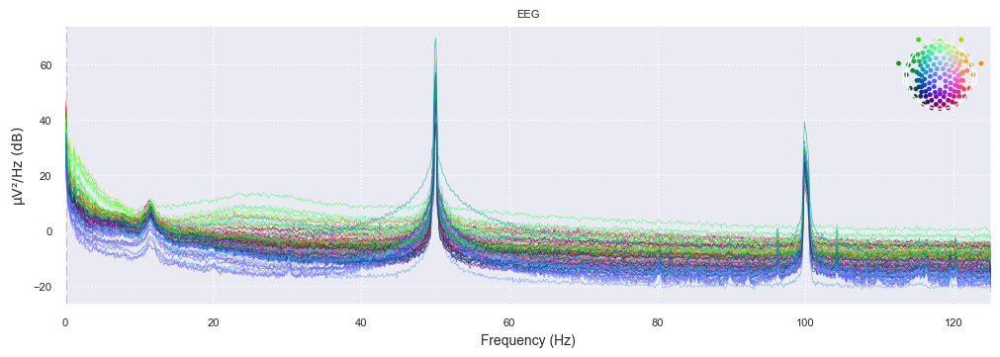

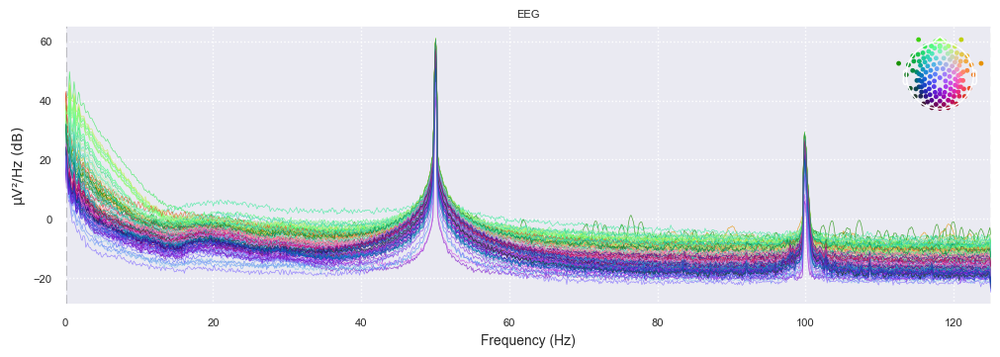

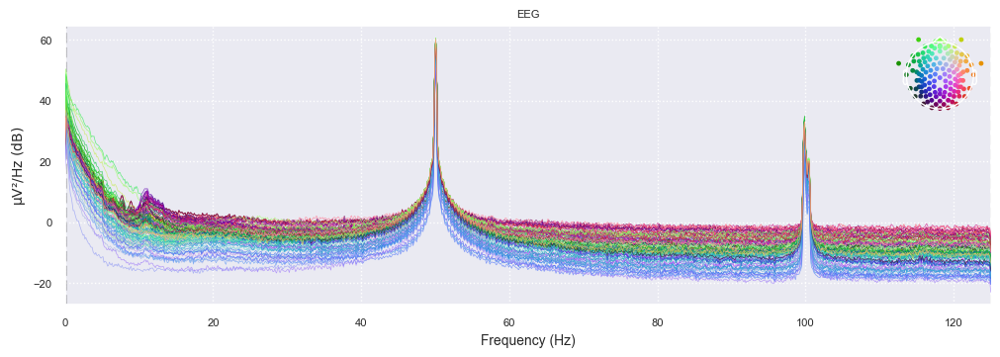

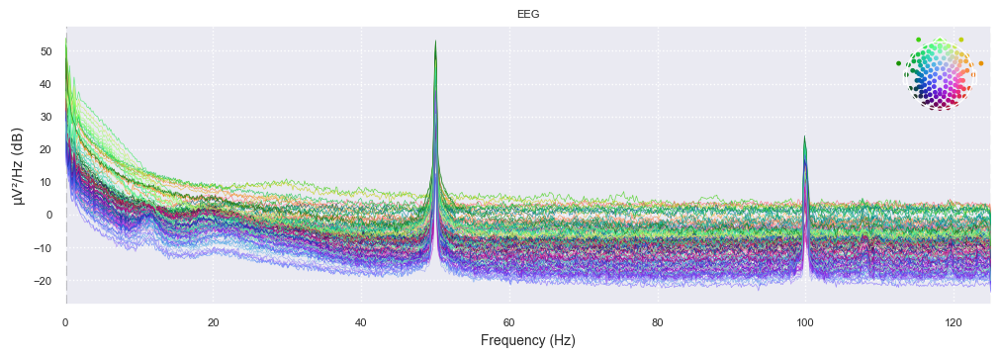

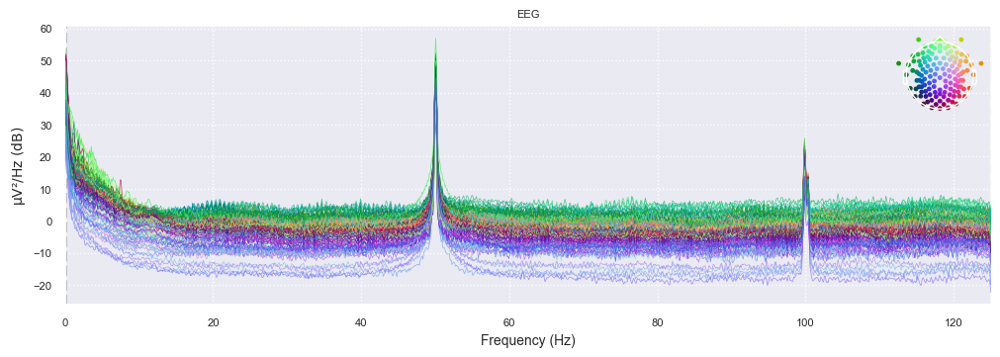

...

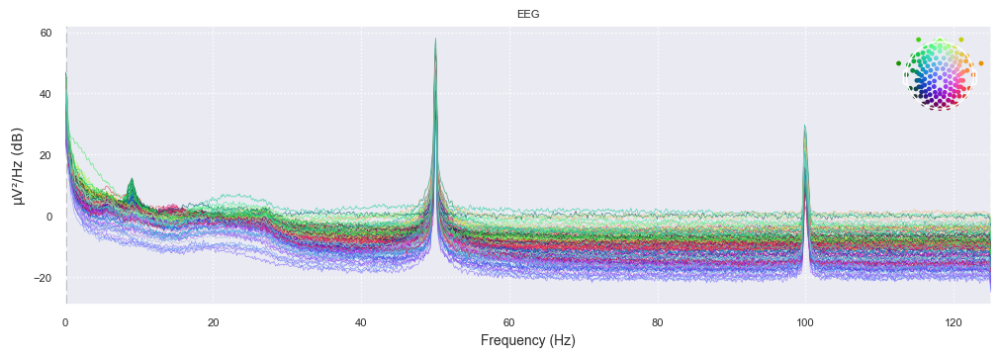

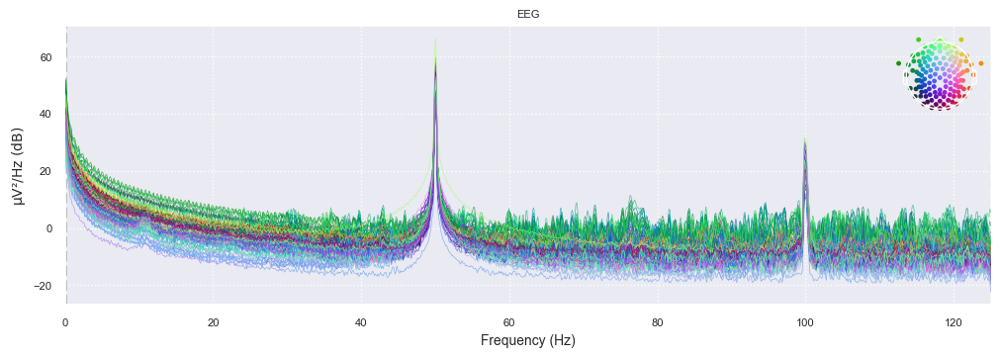

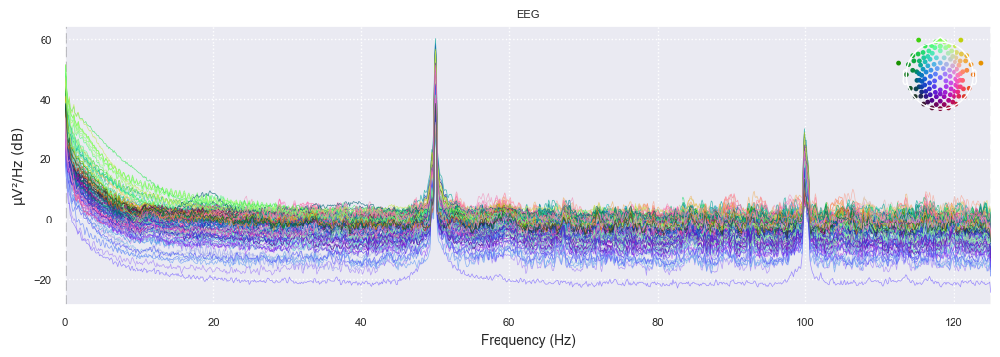

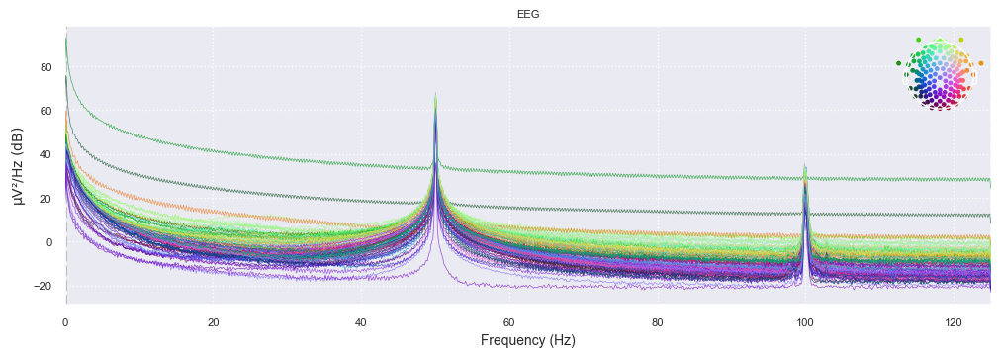

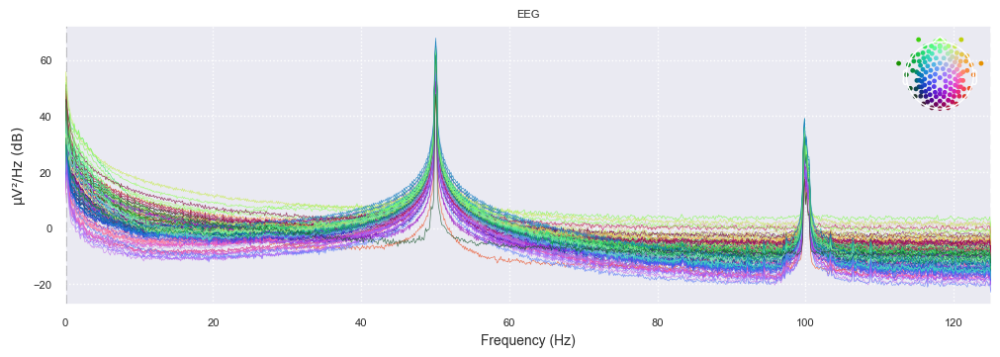

In [33]:
# trích xuất đặc trưng từ file .raw
final_patient_df = pd.DataFrame()

for root, dirs, files in os.walk("C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_ERP_Lanzhou_2015/EEG_128channels_ERP_lanzhou_2015"):
  folder = "C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_ERP_Lanzhou_2015/EEG_128channels_ERP_lanzhou_2015"
  for index, file in enumerate(files):
      if file[-3:]=='raw':
        fin = str(folder)+ "/" + str(file) # tệp raw đầu vào
        df = file_importer(fin) 
        fear,happy,sad = channel_explorer(df) # trích xuất từng cái kích thích lên
        lf_psd_params = pd.concat([signal_extractor(fear,'fear'),signal_extractor(happy,'happy'),signal_extractor(sad,'sad')],axis=1) # ghép 3 cái vào
        nlf_psd_params = pd.concat([nli_features(fear,'fear'),nli_features(happy,'happy'),nli_features(sad,'sad')],axis = 1)
        result = pd.concat([lf_psd_params,nlf_psd_params],axis = 1) # nối cả linear & non-linear
        result = result[result.index.isin(list(Electrode_map.values()))] # chỉ lấy của 16 cực đã chọn
        result_single_row = pd.DataFrame()
        for i in list(Electrode_map.values()):
          temp = pd.DataFrame(result[result.index == i].values)
          temp.columns = [j+'_'+i for j in result.columns]
          result_single_row = pd.concat([result_single_row,temp],axis = 1) 
        result_single_row['patient_identifier'] = file
        final_patient_df = pd.concat([final_patient_df,result_single_row],axis = 0)
        del df
print ("DONE------------------------------------")


Creating RawArray with float64 data, n_channels=128, n_times=75189
    Range : 0 ... 75188 =      0.000 ...   300.752 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75339
    Range : 0 ... 75338 =      0.000 ...   301.352 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.8s


Creating RawArray with float64 data, n_channels=128, n_times=75226
    Range : 0 ... 75225 =      0.000 ...   300.900 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.4s


Creating RawArray with float64 data, n_channels=128, n_times=78639
    Range : 0 ... 78638 =      0.000 ...   314.552 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    2.0s


Creating RawArray with float64 data, n_channels=128, n_times=82651
    Range : 0 ... 82650 =      0.000 ...   330.600 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    2.4s


Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    3.8s


Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    2.0s


Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.2s


Creating RawArray with float64 data, n_channels=128, n_times=75176
    Range : 0 ... 75175 =      0.000 ...   300.700 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75652
    Range : 0 ... 75651 =      0.000 ...   302.604 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75201
    Range : 0 ... 75200 =      0.000 ...   300.800 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75351
    Range : 0 ... 75350 =      0.000 ...   301.400 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s


Creating RawArray with float64 data, n_channels=128, n_times=75401
    Range : 0 ... 75400 =      0.000 ...   301.600 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s


Creating RawArray with float64 data, n_channels=128, n_times=75127
    Range : 0 ... 75126 =      0.000 ...   300.504 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75276
    Range : 0 ... 75275 =      0.000 ...   301.100 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=75089
    Range : 0 ... 75088 =      0.000 ...   300.352 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75389
    Range : 0 ... 75388 =      0.000 ...   301.552 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s


Creating RawArray with float64 data, n_channels=128, n_times=75176
    Range : 0 ... 75175 =      0.000 ...   300.700 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.7s


Creating RawArray with float64 data, n_channels=128, n_times=75402
    Range : 0 ... 75401 =      0.000 ...   301.604 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\_mpl_figure.py:2365: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(FigureClass=FigureClass, **kwargs)
c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    2.3s


Creating RawArray with float64 data, n_channels=128, n_times=75289
    Range : 0 ... 75288 =      0.000 ...   301.152 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s


Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.8s


Creating RawArray with float64 data, n_channels=128, n_times=76039
    Range : 0 ... 76038 =      0.000 ...   304.152 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=75251
    Range : 0 ... 75250 =      0.000 ...   301.000 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.8s


Creating RawArray with float64 data, n_channels=128, n_times=75138
    Range : 0 ... 75137 =      0.000 ...   300.548 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s


Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.2s


Creating RawArray with float64 data, n_channels=128, n_times=75189
    Range : 0 ... 75188 =      0.000 ...   300.752 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s


Creating RawArray with float64 data, n_channels=128, n_times=75163
    Range : 0 ... 75162 =      0.000 ...   300.648 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s


Creating RawArray with float64 data, n_channels=128, n_times=75376
    Range : 0 ... 75375 =      0.000 ...   301.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.8s


Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=75201
    Range : 0 ... 75200 =      0.000 ...   300.800 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=83876
    Range : 0 ... 83875 =      0.000 ...   335.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s


Creating RawArray with float64 data, n_channels=128, n_times=83164
    Range : 0 ... 83163 =      0.000 ...   332.652 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.7s


Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.5s


Creating RawArray with float64 data, n_channels=128, n_times=75525
    Range : 0 ... 75524 =      0.000 ...   302.096 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.0s


Creating RawArray with float64 data, n_channels=128, n_times=75513
    Range : 0 ... 75512 =      0.000 ...   302.048 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.6s


Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75688
    Range : 0 ... 75687 =      0.000 ...   302.748 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.0s


Creating RawArray with float64 data, n_channels=128, n_times=75750
    Range : 0 ... 75749 =      0.000 ...   302.996 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.0s


Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.0s


Creating RawArray with float64 data, n_channels=128, n_times=75188
    Range : 0 ... 75187 =      0.000 ...   300.748 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75158
    Range : 0 ... 75157 =      0.000 ...   300.628 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


Creating RawArray with float64 data, n_channels=128, n_times=75164
    Range : 0 ... 75163 =      0.000 ...   300.652 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.3s


Creating RawArray with float64 data, n_channels=128, n_times=75113
    Range : 0 ... 75112 =      0.000 ...   300.448 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.4s


Creating RawArray with float64 data, n_channels=128, n_times=75127
    Range : 0 ... 75126 =      0.000 ...   300.504 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.2s


Creating RawArray with float64 data, n_channels=128, n_times=75275
    Range : 0 ... 75274 =      0.000 ...   301.096 secs
Ready.
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
Effective window size : 8.192 (s)


c:\Users\ThuyLe\AppData\Local\Programs\Python\Python311\Lib\site-packages\mne\viz\utils.py:165: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 111 samples (0.444 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.9s


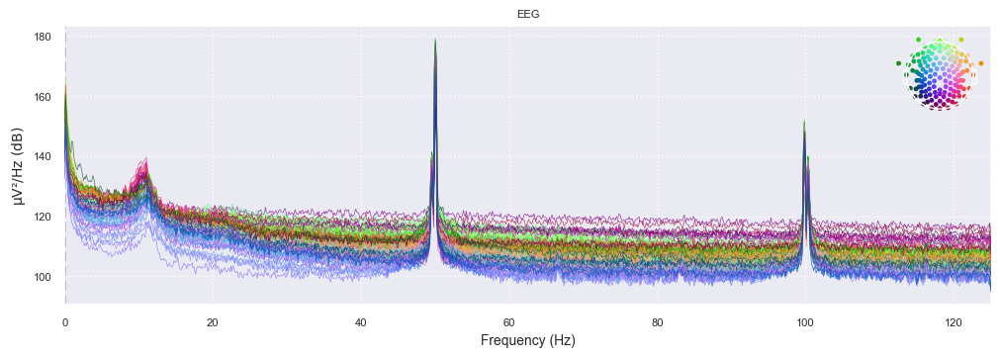

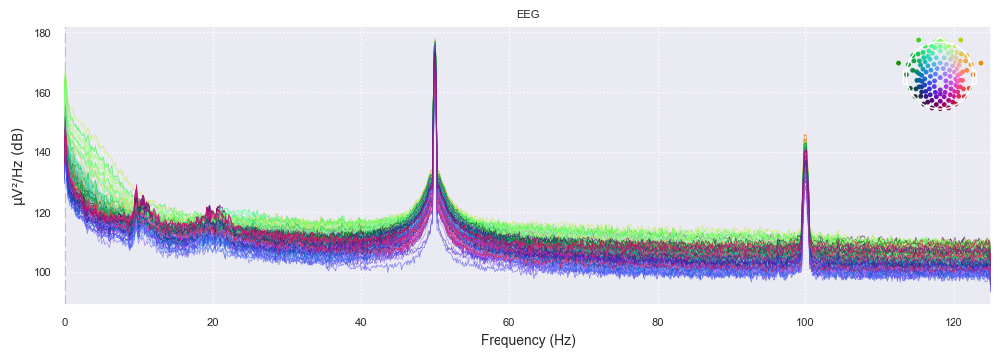

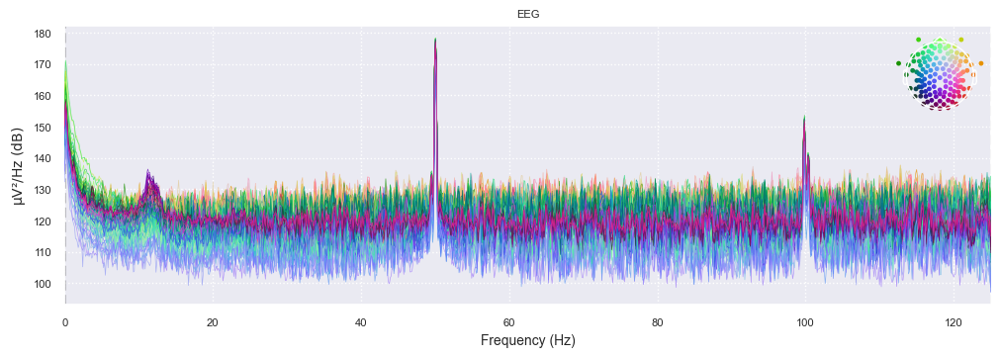

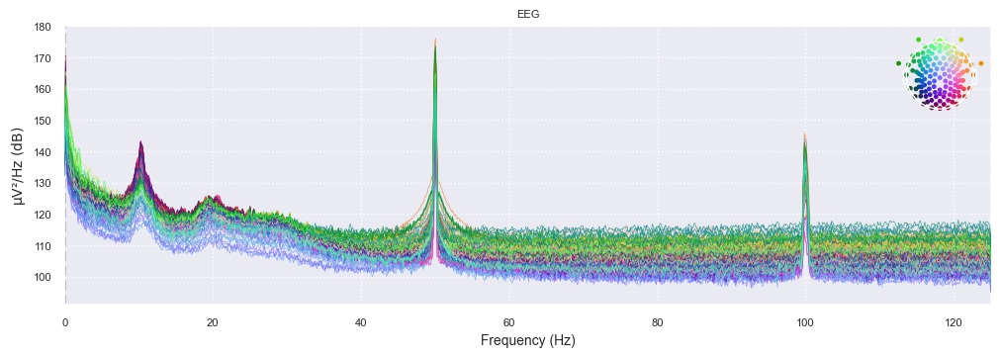

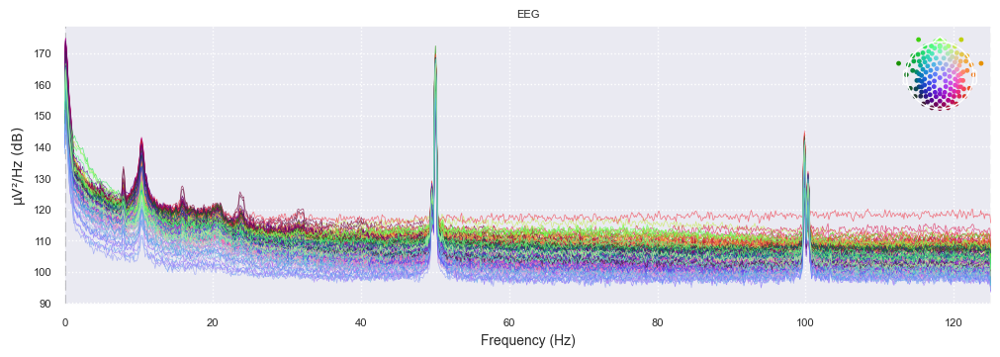

...

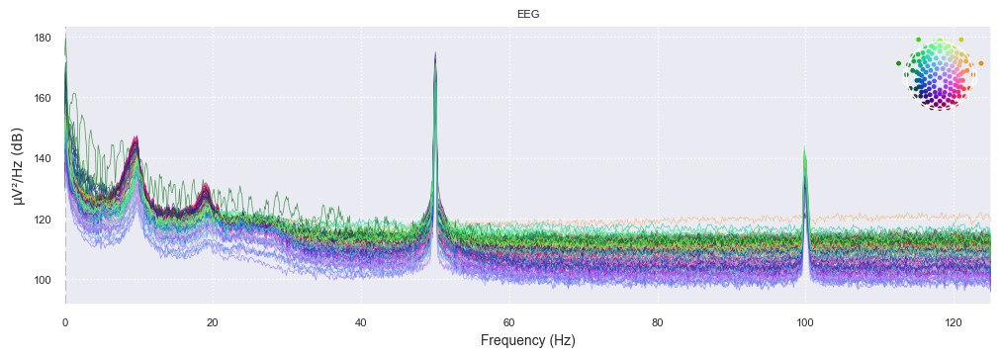

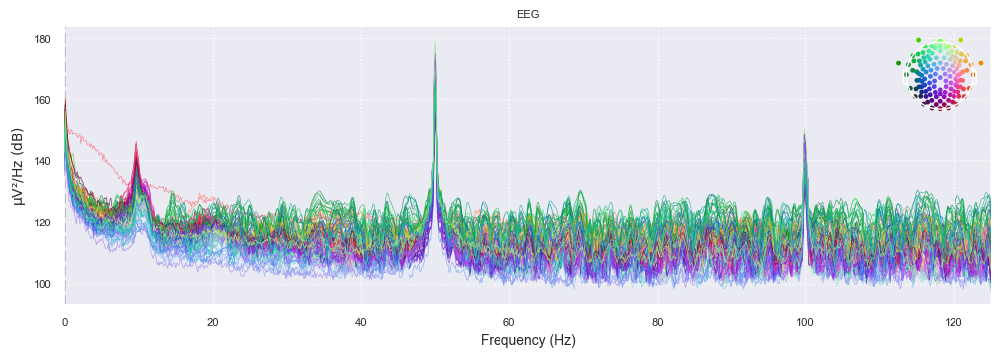

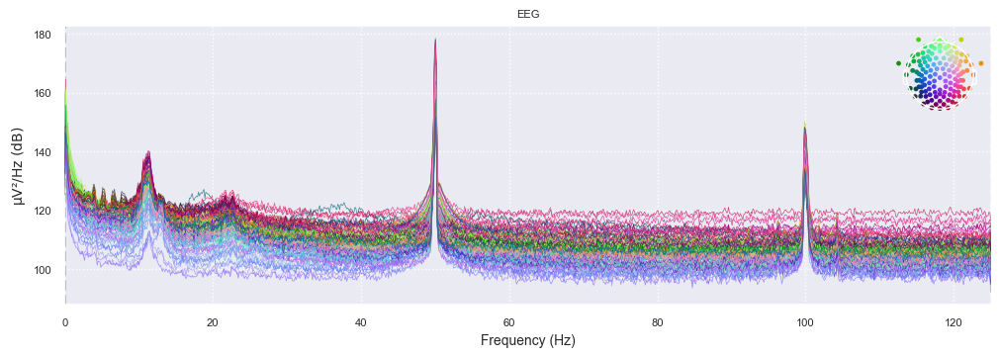

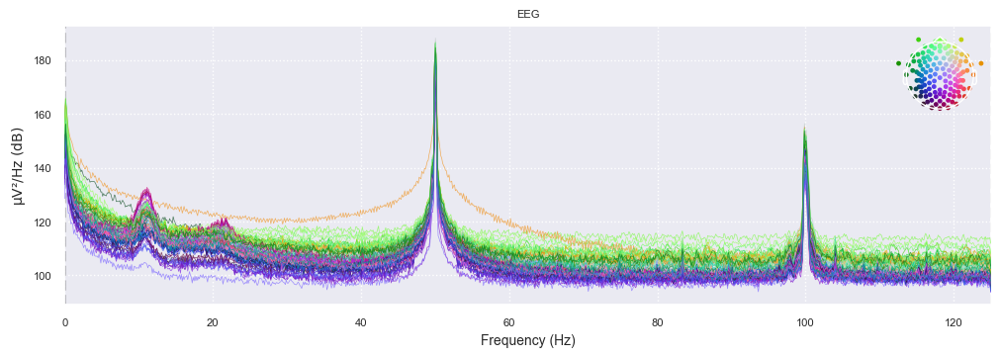

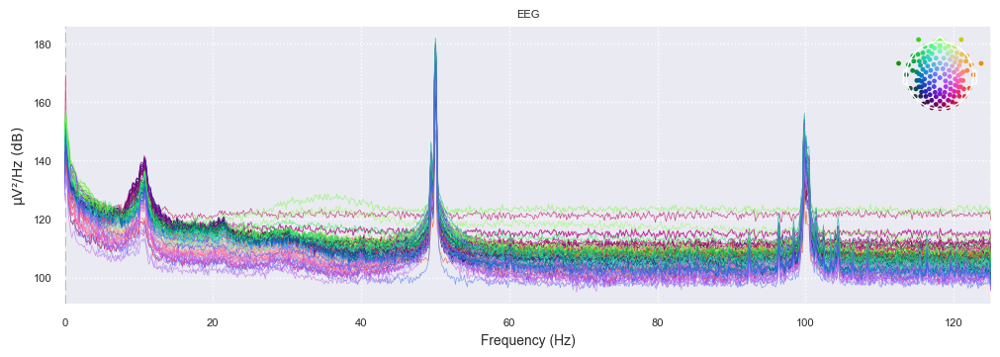

In [85]:
final_patient_resting_1 = pd.DataFrame()

for root, dirs, files in os.walk("C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_Resting_Lanzhou_2015/EEG_128channels_resting_lanzhou_2015"):
  folder = "C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_Resting_Lanzhou_2015/EEG_128channels_resting_lanzhou_2015"
  for index, file in enumerate(files):
      if file[-3:]=='mat':
        fin = str(folder)+"/"+str(file)
        df = file_importer(path=fin,type =0)
        lf_psd_params = signal_extractor(df,'resting')
        nlf_psd_params = nli_features(df,'resting') #trích xuất đặc trưng phi tuyến
        result = pd.concat([lf_psd_params,nlf_psd_params],axis = 1)
        result = result[result.index.isin(list(Electrode_map.values()))]
        result_single_row = pd.DataFrame()
        for i in list(Electrode_map.values()):
          temp = pd.DataFrame(result[result.index == i].values)
          temp.columns = [j+'_'+i for j in result.columns]
          result_single_row = pd.concat([result_single_row,temp],axis = 1) 
        result_single_row['patient_identifier'] = file
        final_patient_resting_1 = pd.concat([final_patient_resting_1,result_single_row],axis = 0)
        del df

In [87]:
# coppy paste:
final_patient_df_copy = final_patient_df
final_patient_resting_1_copy = final_patient_resting_1
# print(final_patient_resting_1_copy.columns)


Index(['alpha_resting_E36', 'beta_resting_E36', 'delta_resting_E36',
       'theta_resting_E36', 'mean_resting_E36', 'max_resting_E36',
       'min_resting_E36', 'median_resting_E36', 'nl_svden_resting_E36',
       'nl_spec_enresting_E36',
       ...
       'delta_resting_E96', 'theta_resting_E96', 'mean_resting_E96',
       'max_resting_E96', 'min_resting_E96', 'median_resting_E96',
       'nl_svden_resting_E96', 'nl_spec_enresting_E96', 'nl_permenresting_E96',
       'patient_identifier'],
      dtype='object', length=177)


In [88]:
# In ra cột có nhãn là 'abc'
print(final_patient_resting_1['patient_identifier'])


0    02010002rest 20150416 1017..mat
0    02010004rest 20150427 1335..mat
0    02010005rest 20150507 0907..mat
0    02010006rest 20150528 0928..mat
0    02010008_rest 20150619 1653.mat
0    02010010rest 20150624 1447..mat
0    02010011rest 20150625 1516..mat
0    02010012rest 20150626 1026..mat
0    02010013rest 20150703 1333..mat
0    02010015rest 20150709 1456..mat
0    02010016rest 20150710 1220..mat
0    02010018rest 20150716 1237..mat
0    02010019rest 20150716 1440..mat
0     02010021 20150805 1730.mat.mat
0    02010022restnew 20150724 14.mat
0    02010023rest 20150729 1929..mat
0    02010024rest 20150814 1504..mat
0     02010025 20160311 1206.mat.mat
0    02010026rest 20160311 1421..mat
0    02010028rest 20160317 1538..mat
0    02010030rest 20160324 1054..mat
0    02010033rest 20160331 1239..mat
0    02010034rest 20160407 0938..mat
0    02010036_rest 20160408 1418.mat
0    02020008rest 20150624 1711..mat
0    02020010rest 20150625 1224..mat
0    02020013rest 20150629 1607..mat
0

In [95]:
final_patient_resting_1['patient_identifier'] = final_patient_resting_1['patient_identifier'].str.extract(r'(\d+)')
final_patient_df['patient_identifier'] = final_patient_df['patient_identifier'].str.extract(r'(\d+)')
# đổi chỉ còn ID

In [97]:
#print(final_patient_resting_1['patient_identifier'])
print(final_patient_df['patient_identifier'])

0    02010002
0    02010004
0    02010005
0    02010006
0    02010008
0    02010010
0    02010011
0    02010012
0    02010013
0    02010015
0    02010016
0    02010018
0    02010019
0    02010021
0    02010022
0    02010023
0    02010024
0    02010025
0    02010026
0    02010028
0    02010030
0    02010033
0    02010034
0    02010036
0    02020008
0    02020010
0    02020013
0    02020014
0    02020015
0    02020016
0    02020018
0    02020019
0    02020020
0    02020021
0    02020022
0    02020023
0    02020025
0    02020026
0    02020027
0    02020029
0    02030002
0    02030003
0    02030004
0    02030005
0    02030006
0    02030007
0    02030009
0    02030014
0    02030017
0    02030018
0    02030019
0    02030020
0    02030021
Name: patient_identifier, dtype: object


# Lưu vào excel

In [98]:
final_patient_resting_1.to_excel('C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/final_patient_resting_1.xlsx', index=False)
final_patient_df.to_excel('C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/final_patient_df.xlsx', index=False)


# **Train model**

In [1]:
import os
from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import scipy.io
from scipy.signal import butter, lfilter
import pandas as pd
import numpy as np
import seaborn as sns
sns.set(font_scale=1.2)

from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.inspection import permutation_importance
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
import shap

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


## ghép nối các excel vào với nhau

In [2]:
df_demog = pd.read_excel('C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/EEG_dataset/854301_EEG_128Channels_ERP_Lanzhou_2015/EEG_128channels_ERP_lanzhou_2015/subjects_information_EEG_128channels_ERP_lanzhou_2015.xlsx',sheet_name = 'Sheet1')
df_erp = pd.read_excel('C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/final_patient_df.xlsx')
df_resting = pd.read_excel('C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/final_patient_resting_1.xlsx')

df_erp['patient_identifier'] = df_erp['patient_identifier'].astype(int)
df_resting['patient_identifier'] = df_resting['patient_identifier'].astype(int) # chuyển đổi về cùng dạng

intermediate_df = pd.merge(df_erp,df_demog,left_on = 'patient_identifier',right_on = 'subject id',how ='inner')
df = pd.merge(intermediate_df,df_resting,left_on = 'patient_identifier',right_on = 'patient_identifier',how ='inner') # ghép nối từng cái một

In [3]:
# bỏ cột không cần thiết
df.drop(columns = ['Unnamed: 11', 'Unnamed: 12','subject id', 'age', 'gender', 'education（years）', 'PHQ-9', 'CTQ-SF'],inplace = True) 

In [4]:
df.drop(columns = ['patient_identifier', 'LES', 'SSRS', 'GAD-7', 'PSQI'],inplace = True) 

In [5]:
# thử xem ghép được như nào
df.to_excel('C:/Users/ThuyLe/Desktop/Diagnosing-depression-using-EEG-main/EEG_main/Excel/intermediate_df.xlsx', index=False)

# Bắt đầu training

In [6]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

X = df.drop(['type'], axis=1)  # Loại bỏ cột nhãn khỏi đặc trưng
y = df['type']  # label



In [7]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

X = df.drop(['type'], axis=1)  # Loại bỏ cột nhãn khỏi đặc trưng
y = df['type']  # label
#print(X.columns)
X_encoded = pd.get_dummies(X, drop_first=True)  # Chuyển đổi cột dạng chuỗi
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)
predictions = model.predict(X_test)
accuracy = accuracy_score(y_test, predictions)
print(f'Accuracy RandomForest: {accuracy}')



Accuracy RandomForest: 0.6363636363636364


In [8]:
rf = RandomForestClassifier()
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)
print(y_train.shape)

Accuracy: 0.45454545454545453
(42,)


In [10]:
from sklearn.metrics import accuracy_score
import numpy as np
# Khởi tạo mô hình
models = {
    'Random Forest': RandomForestClassifier(random_state=42),
    'Logistic Regression': LogisticRegression(random_state=42),
    'KNN': KNeighborsClassifier(7),
    'SVC': SVC(random_state=42)
}


X_train_np = X_train.values  # Chuyển DataFrame sang mảng NumPy
X_test_np = X_test.values

for name, model in models.items():
    model.fit(X_train_np, y_train)  # Huấn luyện mô hình
    predictions = model.predict(X_test_np)  # Dự đoán trên tập kiểm tra
    accuracy = accuracy_score(y_test, predictions)  # Tính độ chính xác
    print(f"{name} Accuracy: {accuracy:.2f}")

print(y_train.shape)


Random Forest Accuracy: 0.64
Logistic Regression Accuracy: 0.73
KNN Accuracy: 0.82
SVC Accuracy: 0.45
(42,)


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
